In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import os
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sb
# import scrublet 
from matplotlib.pyplot import rc_context
mpl.rcParams['pdf.fonttype'] = 42
mpl.rcParams["font.sans-serif"] = "Arial"
%config InlineBackend.figure_format = 'retina'
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Reds')

In [11]:
# adata=sc.read_h5ad('/disk212/yupf/database/scRNA-seq/NewAtlas/atlas_level3_with_meta.h5ad')
adata=sc.read_h5ad('/disk212/yupf/database/scRNA-seq/NewAtlas/atlas_level3_v2.h5ad')

## Epithelial

In [ ]:
# Epithelial
"Stem":['LGR5',"OLFM4",'HMGB2']
"Transit-amplifying":['TOP2A','PCNA','DUT',"UBE2C"]
"Paneth":['PIGR','MMP7','CPSF6']
"Microfold":['GP2']
"Goblet cells":['CLCA1','SPDEF', 'TFF3','REG4','SPINK4']
"Tuft cells":['POU2F3','IRAG2']
"BEST4 enterocytes":['BEST4', 'OTOP2','CFTR','NOTCH2','CA7']
"Enterocytes":['RBP2', 'ANPEP', 'FABP2']
"coloncytes":['CA2', 'SLC26A2', 'ENSSSCG00000008214']
"EEC":['CHGA','CHGB','NEUROD1']

In [9]:
epi=adata[adata.obs['Lineage']=='Epithelial lineage']

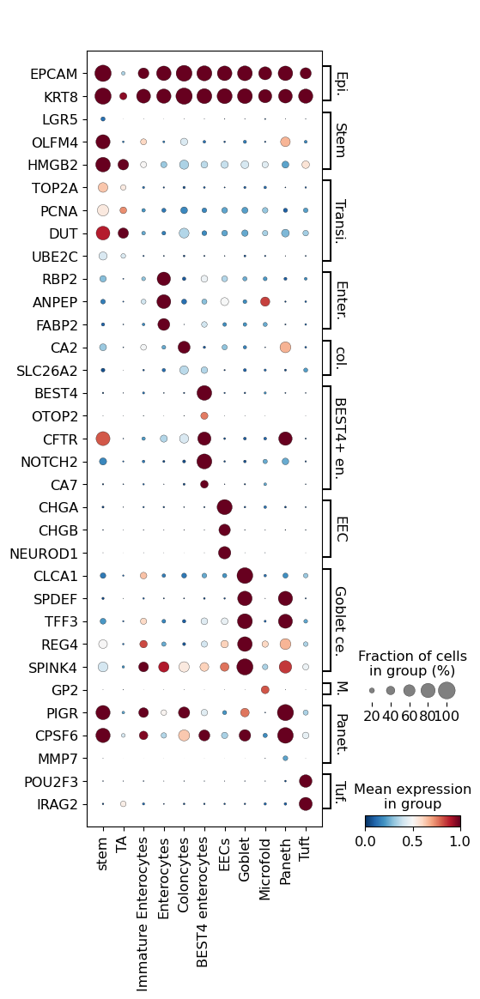

In [16]:
marker_genes_dict = {
"Epithelial":['EPCAM','KRT8'],
"Stem":['LGR5',"OLFM4",'HMGB2'],
"Transit-amplifying":['TOP2A','PCNA','DUT',"UBE2C"],
"Enterocytes":['RBP2', 'ANPEP', 'FABP2'],
"coloncytes":['CA2', 'SLC26A2'],
"BEST4+ enterocytes":['BEST4', 'OTOP2','CFTR','NOTCH2','CA7'],
"EEC":['CHGA','CHGB','NEUROD1'],
"Goblet cells":['CLCA1','SPDEF', 'TFF3','REG4','SPINK4'],
"Microfold":['GP2'],
"Paneth":['PIGR','CPSF6','MMP7'],
"Tuft cells":['POU2F3','IRAG2']
}
sc.pl.dotplot(epi,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_epi.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## B/plasma cell,red blood cells

In [ ]:
# B/plasma cell,red blood cells
"plasma":['JCHAIN','XBP1','IRF4','PRDM1']
"Resting B":['KLF2','SELL','CCR7']
"cycling B":['PCLAF','BIRC5','TOP2A','STMN1']
"activated B":['AICDA', 'BCL6','CD86','CD79B','MS4A1']

In [26]:
adata.obs['Lineage']

AAACCCAAGAGTTGAT-1_CNP0002165                    B lineage
AAACCCAAGCAACTTC-1_CNP0002165                    B lineage
AAACCCAAGCAGTCTT-1_CNP0002165           Epithelial lineage
AAACCCAAGCGCATCC-1_CNP0002165                    B lineage
AAACCCAAGGGTAGCT-1_CNP0002165                    B lineage
                                               ...        
TTTGTTGCAATCGCCG-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACCTAGT-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTACTAAGA-1_PRJNA859792_NoPP4         T/ILC lineage
TTTGTTGGTTTCGCTC-1_PRJNA859792_NoPP4    Epithelial lineage
TTTGTTGTCAGTGTCA-1_PRJNA859792_NoPP4         T/ILC lineage
Name: Lineage, Length: 589101, dtype: category
Categories (8, object): ['Epithelial lineage', 'B lineage', 'T/ILC lineage', 'Myeloid lineage', 'Endothelial lineage', 'Mesenchymal lineage', 'Neuron Lineage', 'Red blood']

In [378]:
B=adata[adata.obs['Lineage']=='B lineage']

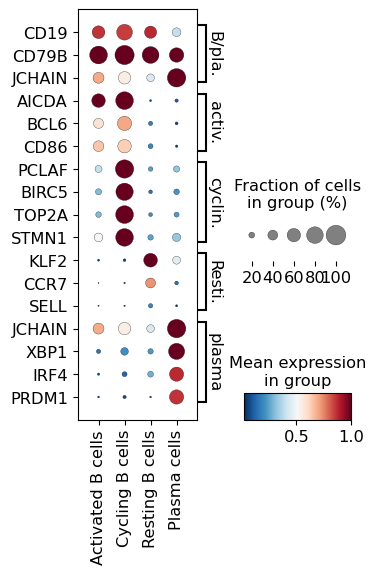

In [397]:
marker_genes_dict = {
"B/plasma cell":['CD19', 'CD79B', 'JCHAIN'],
"activated B":['AICDA', 'BCL6','CD86'],
"cycling B":['PCLAF','BIRC5','TOP2A','STMN1'],
"Resting B":['KLF2','CCR7','SELL'],
"plasma":['JCHAIN','XBP1','IRF4','PRDM1']
}
sc.pl.dotplot(B,marker_genes_dict , groupby='CellType',cmap='RdBu_r',figsize=(3.5,5),vmax=1,swap_axes=True,save='_marker_B.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## T

In [12]:
# T 
T=adata[adata.obs['Lineage']=='T/ILC lineage']

/tmp/ipykernel_1511847/2055532332.py:3: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(T, resolution = 0.5)


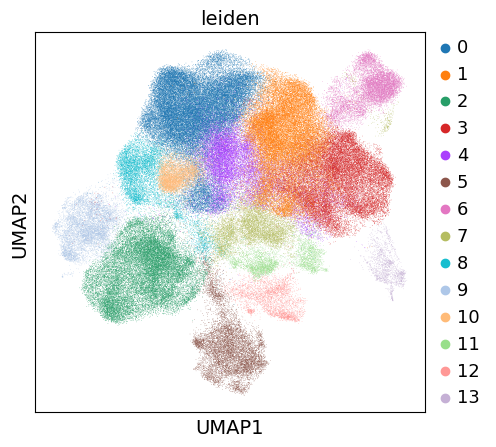

In [6]:
sc.pp.neighbors(T, use_rep = 'X_scVI')
sc.tl.umap(T)
sc.tl.leiden(T, resolution = 0.5)
sc.pl.umap(T, color='leiden')

CD4 is in T.var_names
CD28 is in T.var_names


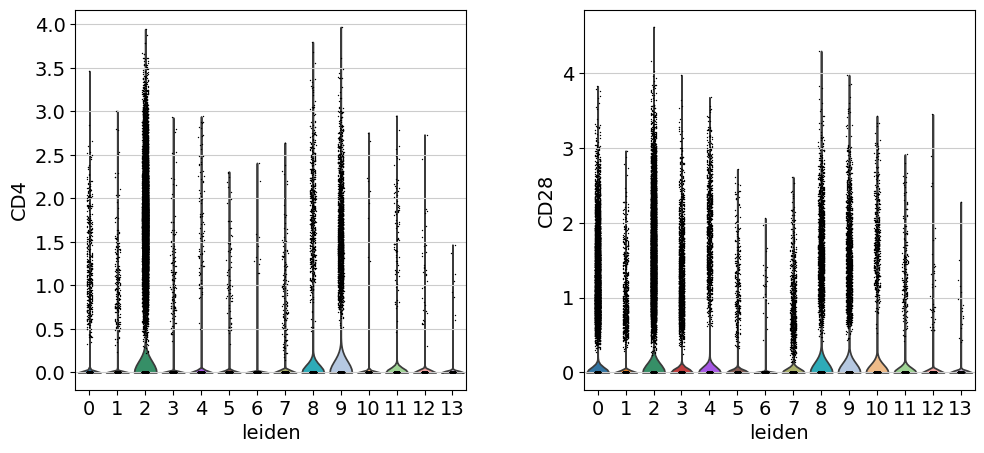

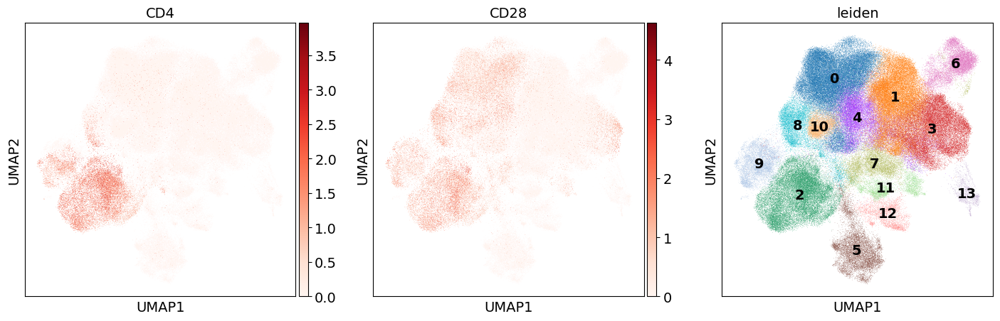

In [8]:
Glist=['CD4','CD28']#CD4 T cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

CD8B is in T.var_names
CD8A is in T.var_names


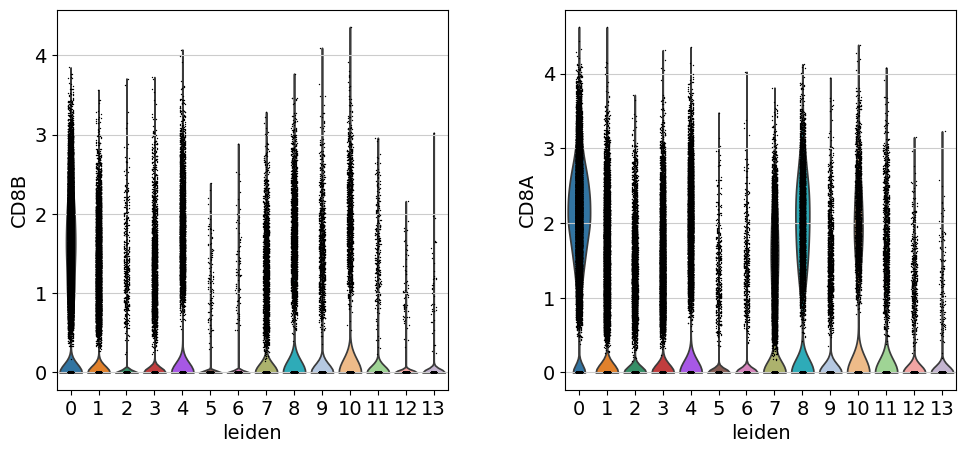

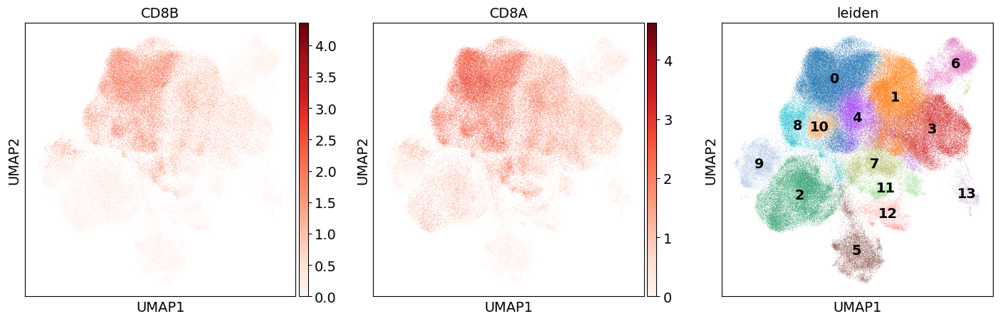

In [9]:
Glist=['CD8B','CD8A']#CD8 T cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

TOX is in T.var_names
FCER1G is in T.var_names
GZMA-1 is in T.var_names
GZMA is in T.var_names
GZMH is in T.var_names


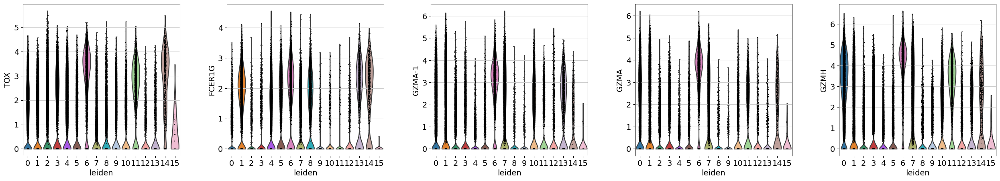

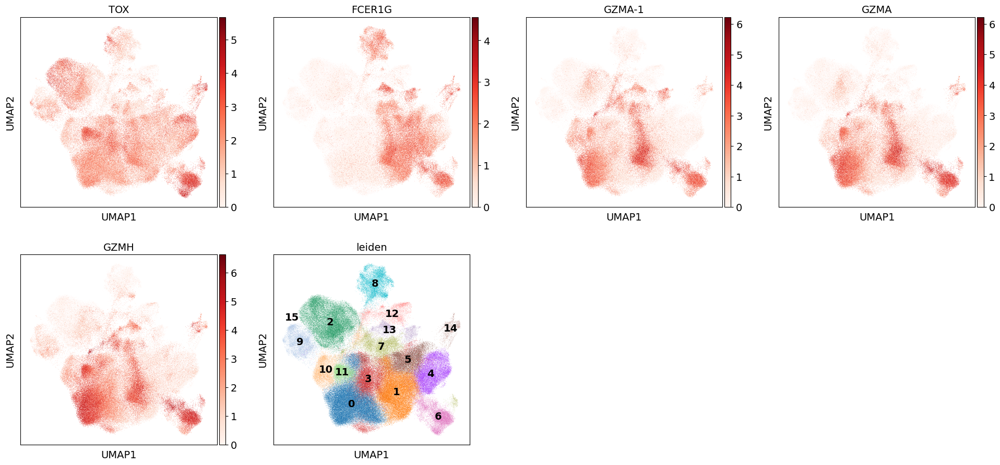

In [ ]:
Glist=['TOX','FCER1G','GZMA-1','GZMA','GZMH']# Cytotoxic T cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

KLRB1 is in T.var_names
CXCL2 is in T.var_names
RORC is in T.var_names
KIT is in T.var_names
IL23R is in T.var_names


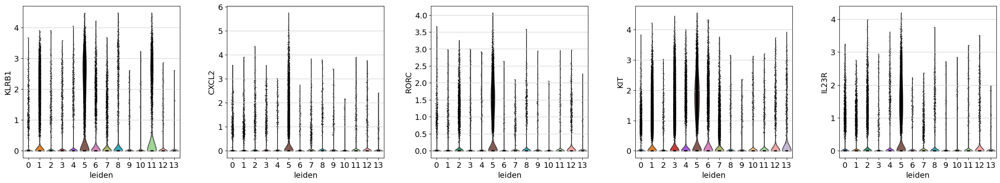

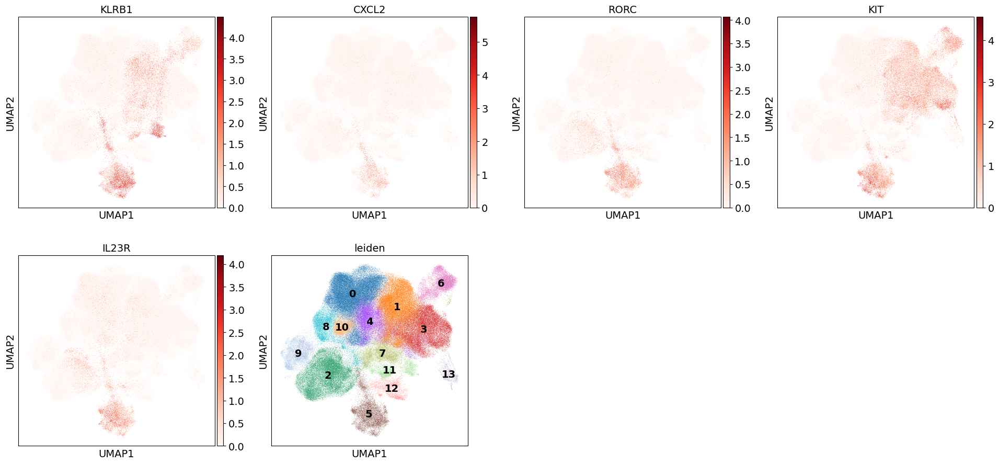

In [ ]:
Glist=['KLRB1','CXCL2','RORC','KIT','IL23R']#ILC _LACK CD3E _high CD2
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

#### gdT

In [27]:
gdt=T[T.obs['leiden']=='12']

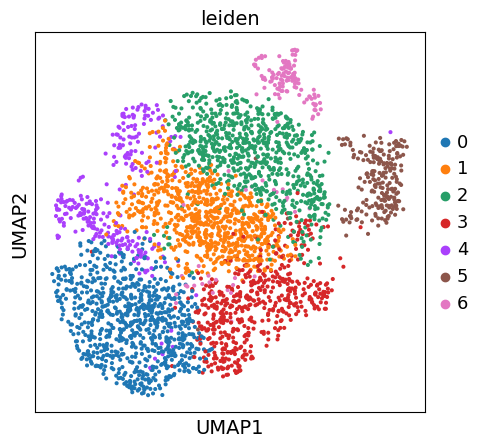

In [30]:
sc.pp.neighbors(gdt, use_rep = 'X_scVI')
sc.tl.umap(gdt)
sc.tl.leiden(gdt, resolution = 0.5)
sc.pl.umap(gdt, color='leiden')

TRDC is in T.var_names
SOX13 is in T.var_names
BLK is in T.var_names
ID3 is in T.var_names
GATA3 is in T.var_names
CD2 is in T.var_names


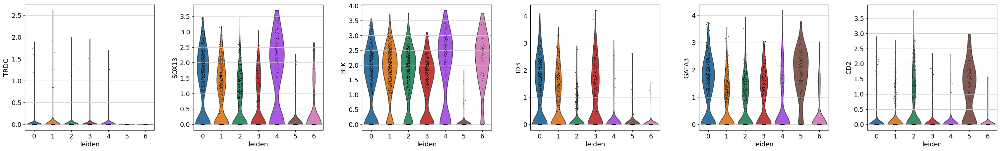

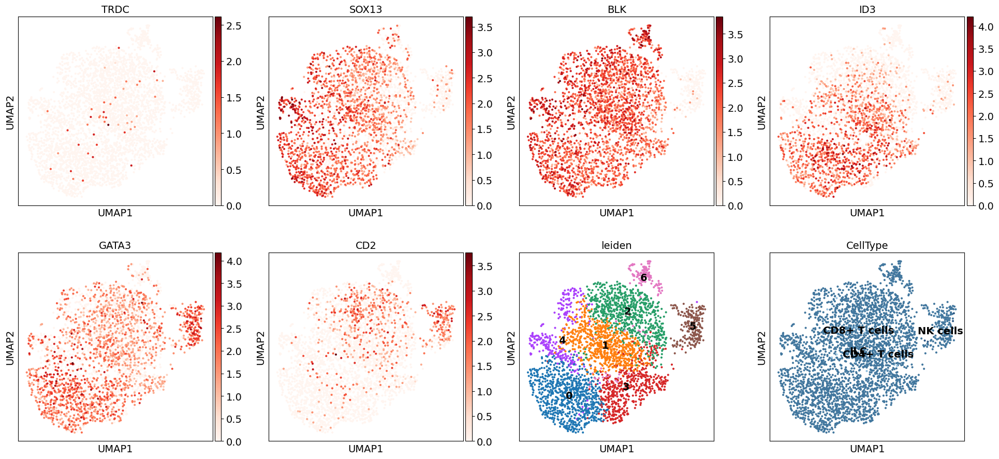

In [ ]:

Glist=['TRDC','SOX13','BLK','ID3','GATA3','CD2'] #γδ T 
for i in Glist[:]:
    if i  in gdt.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(gdt, keys=Glist,groupby='leiden')
Glist.append('leiden')
Glist.append('CellType')
sc.pl.umap(gdt, color=Glist,legend_loc='on data')

In [32]:
def function(a):
    if a in ['2','5']:
        return "CD2+ gd T cells"
    elif a in ['0','1','3','4','6']:
        return "CD2- gd T cells"
df = gdt.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
gdt.obs=df
#跨列操作，与axis=0对应

In [37]:
gdt.obs['CellType'].value_counts()

CellType
CD2- gd T cells    2510
CD2+ gd T cells     936
Name: count, dtype: int64

In [44]:
adata_celltypes = np.unique(adata.obs['CellType'])
gdt_celltypes = np.unique(gdt.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(gdt_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [45]:
adata.obs.loc[gdt.obs_names,'CellType'] = gdt.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

#### ILC

In [13]:
# ILC
ILC=T[T.obs['CellType']=='ILC']

In [18]:
ILC

View of AnnData object with n_obs × n_vars = 12829 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym', 'level3', 'Dataset', 'segment', 'stage', 'weaned', 'Disease', 'gender', 'region', 'breed', 'project', 'age'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'CellType_colors', 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'level3_colors', 'lym_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'stage_colors', 'tsne', 'umap'
    obsm: 'X_scVI', 'X_tsne', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

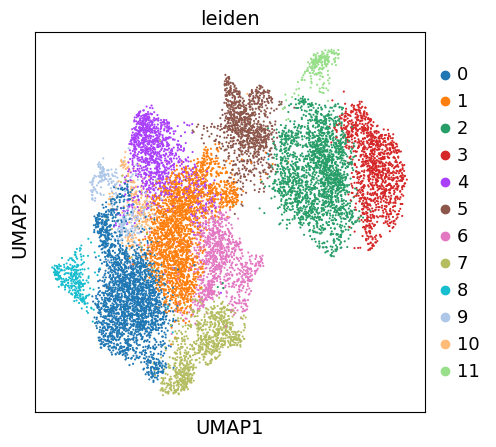

In [20]:
sc.pp.neighbors(ILC, use_rep = 'X_scVI')
sc.tl.umap(ILC)
sc.tl.leiden(ILC, resolution = 0.5)
sc.pl.umap(ILC, color='leiden')

CD2 is in T.var_names
KIT is in T.var_names
IL7R is in T.var_names
IL23R is in T.var_names
NCR is not in T.var_names
AHR is in T.var_names


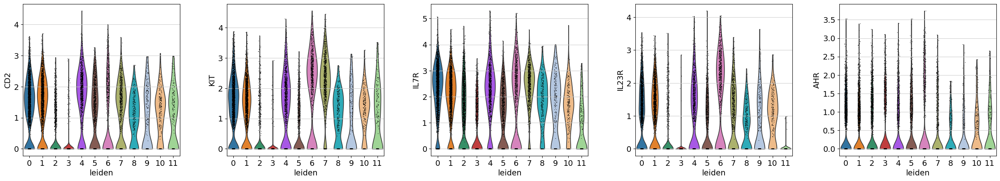

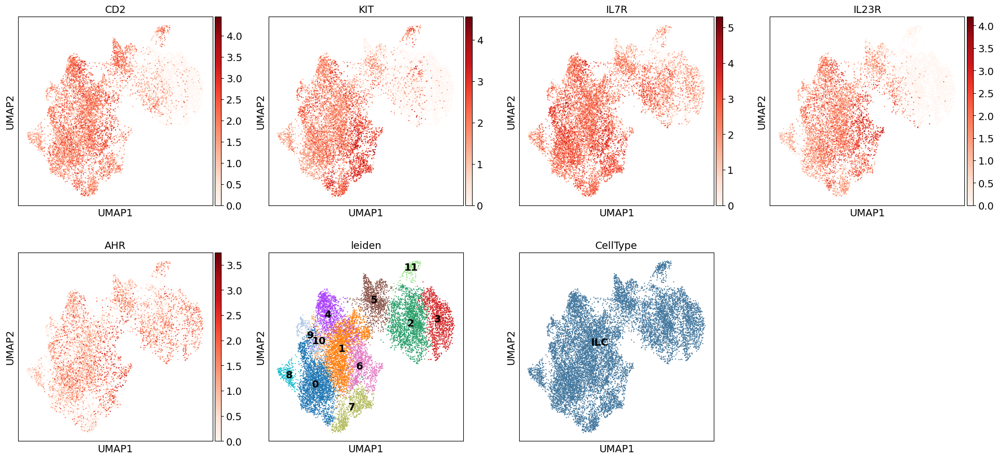

In [21]:
#ILC3
Glist=['CD2','KIT','IL7R','IL23R','NCR','AHR']
for i in Glist[:]:
    if i  in ILC.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(ILC, keys=Glist,groupby='leiden')
Glist.append('leiden')
Glist.append('CellType')
sc.pl.umap(ILC, color=Glist,legend_loc='on data')

CD3G is in T.var_names
CD247 is in T.var_names
CD96 is in T.var_names
SLA-DRA is not in T.var_names
ITGAE is in T.var_names


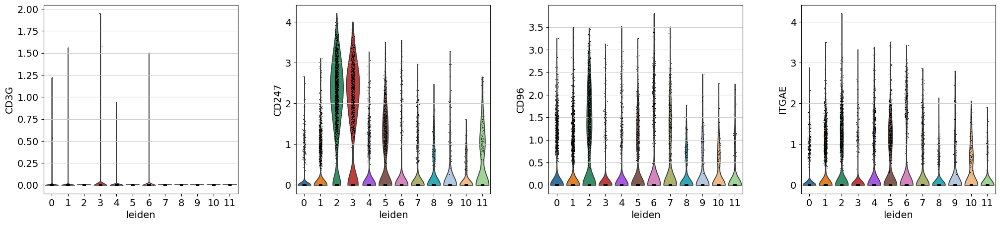

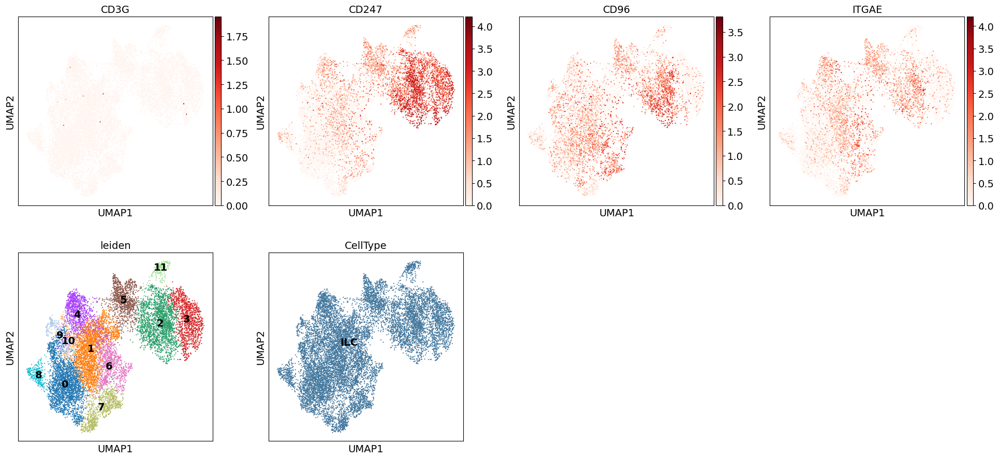

In [22]:
# ILC1
Glist=['CD3G','CD247','CD96','SLA-DRA','ITGAE']
for i in Glist[:]:
    if i  in ILC.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(ILC, keys=Glist,groupby='leiden')
Glist.append('leiden')
Glist.append('CellType')
sc.pl.umap(ILC, color=Glist,legend_loc='on data')

PTGDR2 is in T.var_names
CD44 is in T.var_names
CD81 is in T.var_names
CCR9 is in T.var_names


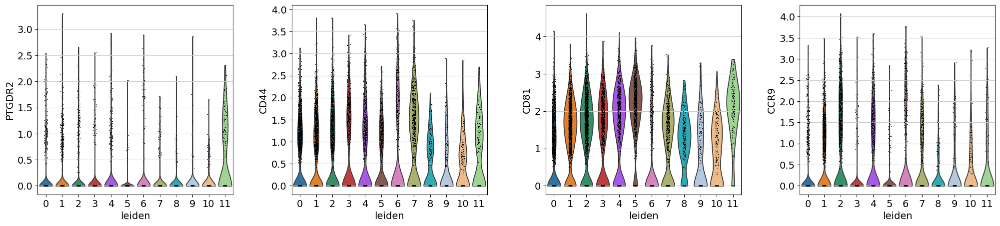

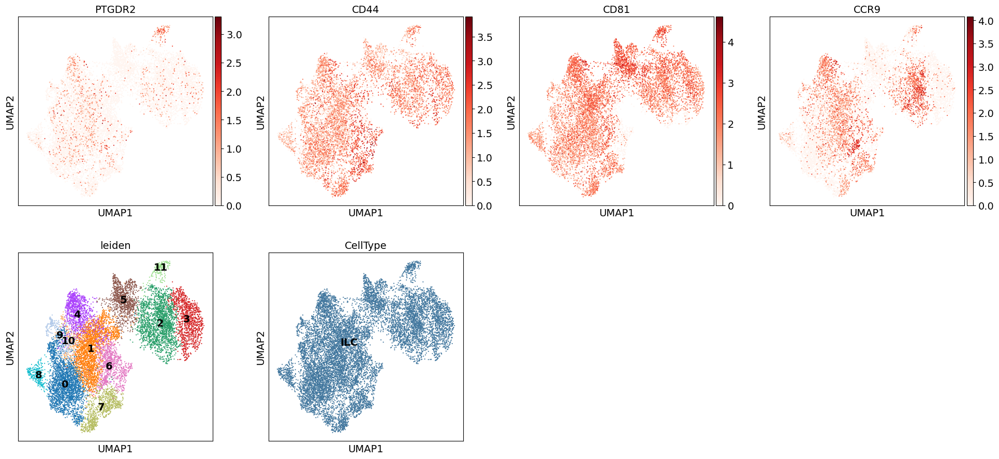

In [23]:
#ILC2
Glist=['PTGDR2','CD44','CD81','CCR9']
for i in Glist[:]:
    if i  in ILC.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(ILC, keys=Glist,groupby='leiden')
Glist.append('leiden')
Glist.append('CellType')
sc.pl.umap(ILC, color=Glist,legend_loc='on data')

In [17]:
def function(a):
    if a in ['0','1','4','6','7','8','9','10']:
        return "ILC3"
    elif a in ['2','3','5']:
        return "ILC1"
    elif a in ['11']:
        return "ILC2"
df = ILC.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
ILC.obs=df
#跨列操作，与axis=0对应

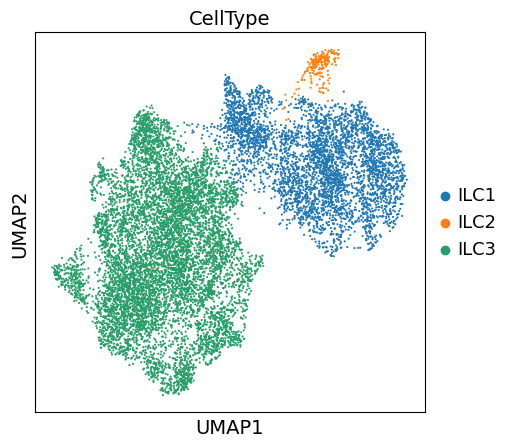

In [26]:
sc.pl.umap(ILC, color=["CellType"])

In [39]:
adata_celltypes = np.unique(adata.obs['CellType'])
ILC_celltypes = np.unique(ILC.obs['CellType'])

# 检查 x.obs['celltype'] 中是否有在 adata.obs['celltype'] 中缺失的类别
missing_celltypes = list(set(ILC_celltypes) - set(adata_celltypes))

# 添加缺失的类别到 adata.obs['celltype']
adata.obs['CellType'] = adata.obs['CellType'].astype('category')
adata.obs['CellType']=adata.obs['CellType'].cat.add_categories(missing_celltypes)

In [41]:
adata.obs.loc[ILC.obs_names,'CellType'] = ILC.obs['CellType'].astype('object')
adata.obs['CellType'] = adata.obs['CellType'].cat.remove_unused_categories()
adata.obs['CellType'] = adata.obs['CellType'].astype('category')

GATA3 is in T.var_names
PTGDR2 is in T.var_names


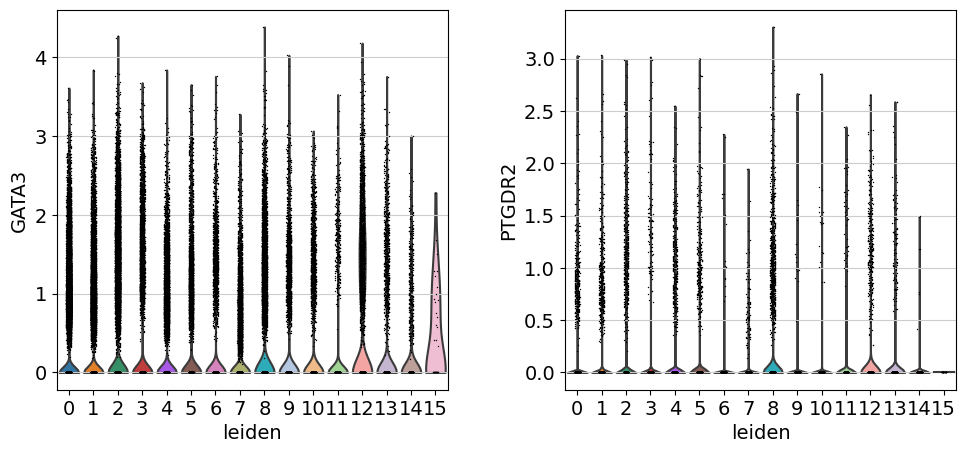

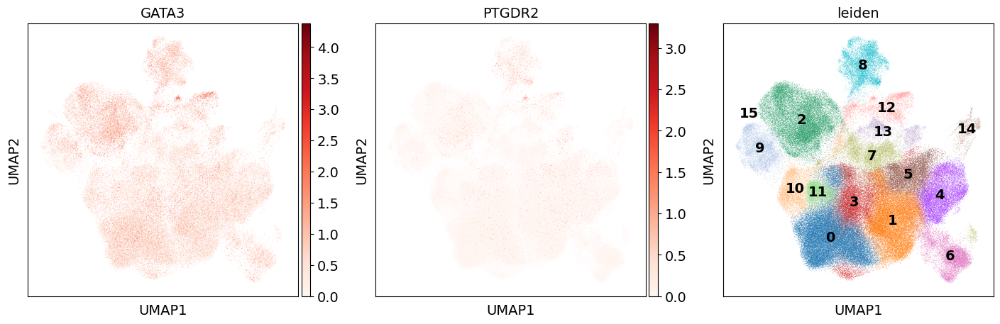

In [ ]:
# Glist=['GATA3','PTGDR2']# ILC_
# for i in Glist[:]:
#     if i  in T.var_names:
#         print(i+' is in T.var_names')
#     else:
#         Glist.remove(i)
#         print(i+' is not in T.var_names')
# sc.pl.violin(T, keys=Glist,groupby='leiden')
# Glist.append('leiden')
# sc.pl.umap(T, color=Glist,legend_loc='on data')

NKG7 is in T.var_names
PRF1 is in T.var_names
GNLY is in T.var_names
KLRB1 is in T.var_names


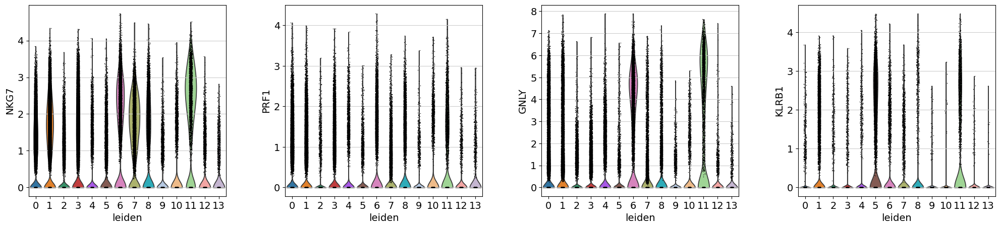

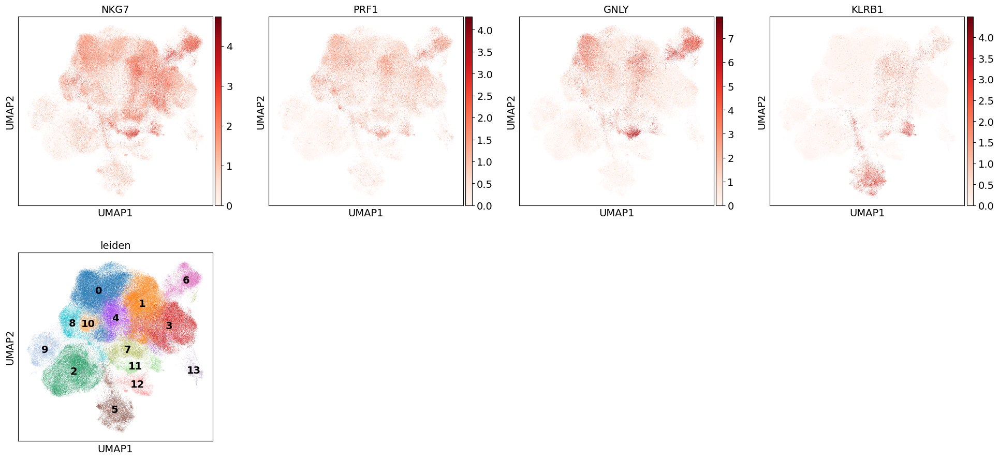

In [16]:
Glist=['NKG7','PRF1','GNLY','KLRB1']#NK cells
for i in Glist[:]:
    if i  in T.var_names:
        print(i+' is in T.var_names')
    else:
        Glist.remove(i)
        print(i+' is not in T.var_names')
sc.pl.violin(T, keys=Glist,groupby='leiden')
Glist.append('leiden')
sc.pl.umap(T, color=Glist,legend_loc='on data')

In [275]:
def function(a):
    if a in ['0','1','3','4','5','7','10','11']:
        return "CD8+ T cells"
    elif a in ['2','9','15']:
        return "CD4+ T cells"
    elif a in ['8','12']:
        return "ILC"
    elif a in ['6']:
        return "Cytotoxic T cells"# GZMA+ GZMH+
    elif a in ['13']:
        return "NK cells"
    elif a in ['14']:
        return "MEF2C+ T cells"#MEF2C
df = T.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
T.obs=df
#跨列操作，与axis=0对应

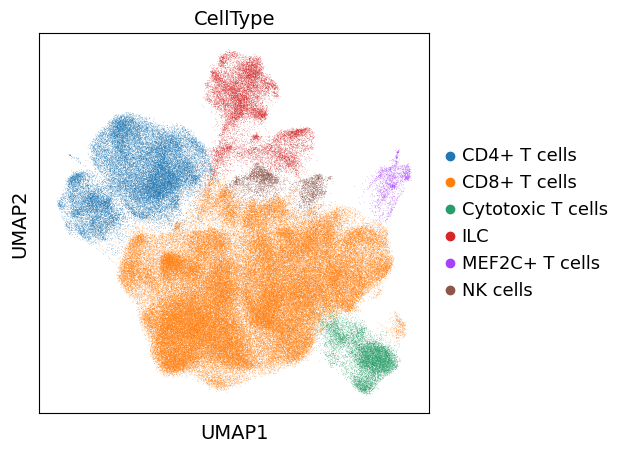

In [276]:
sc.pl.umap(T, color=["CellType"])

In [260]:
df=adata.obs[['CellType']].astype(str)

In [404]:
df=adata.obs[['CellType']].astype(str)
df2=T.obs[['CellType']].astype(str)
df=df.drop(df.index.intersection(df2.index))
df=pd.concat([df, df2])
# df=df.astype('category')
adata.obs['CellType']=df
adata.obs['CellType']=adata.obs['CellType'].astype('category')

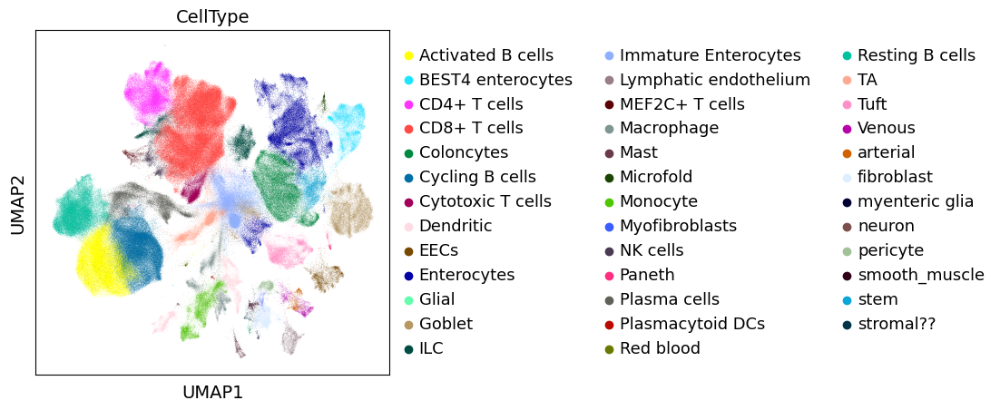

In [268]:
sc.pl.umap(adata,color='CellType')

### cluster14 MEF2C+

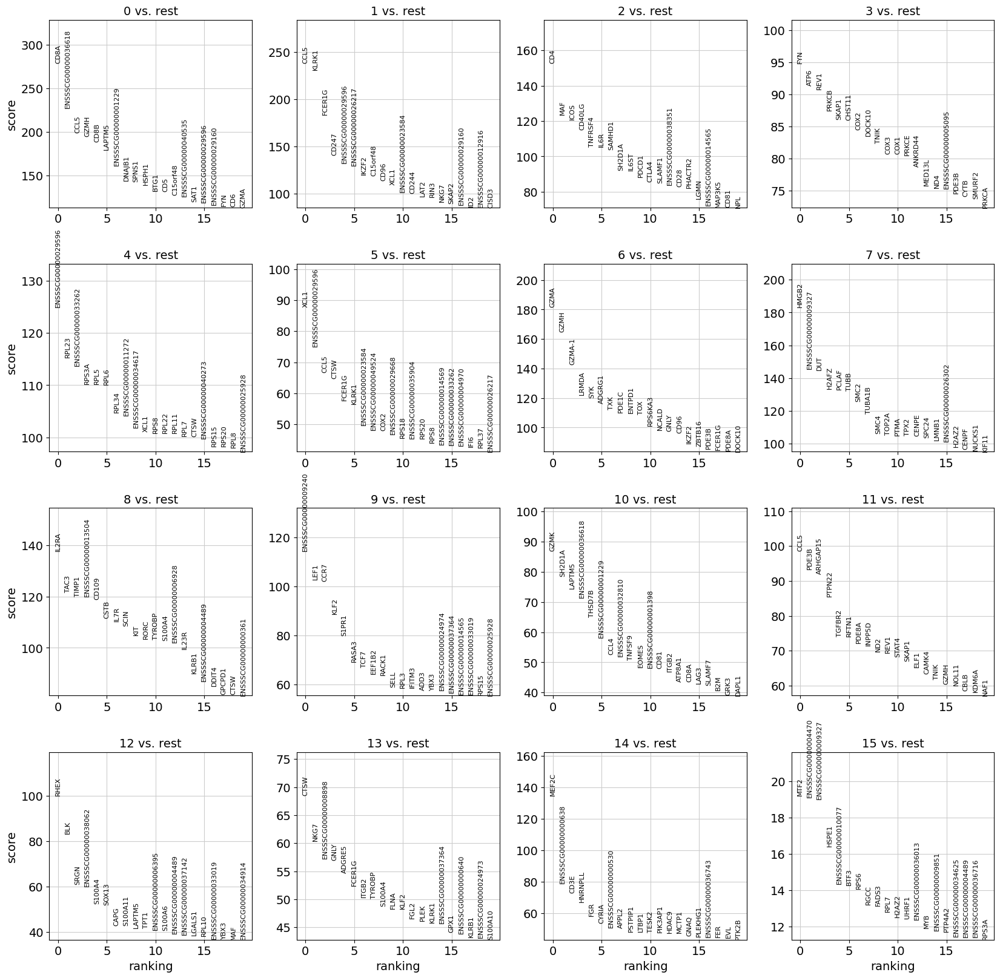

In [69]:
sc.tl.rank_genes_groups(T, 'leiden',n_genes=20)
sc.pl.rank_genes_groups(T, n_genes=20, sharey=False)

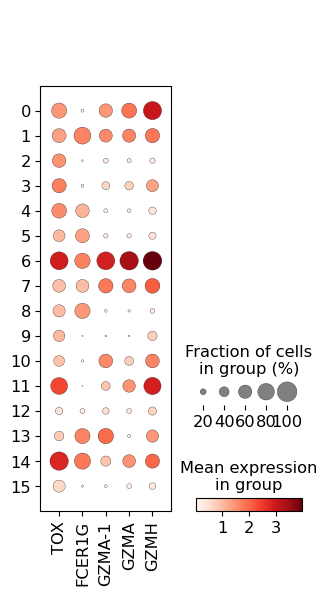

In [103]:
sc.pl.dotplot(T,var_names=['TOX','FCER1G','GZMA-1','GZMA','GZMH'],groupby='leiden')

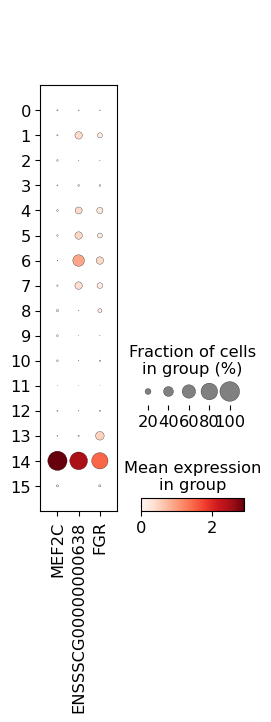

In [74]:
sc.pl.dotplot(T,var_names=['MEF2C','ENSSSCG00000000638','FGR'],groupby='leiden')

In [77]:
cluster14=T[T.obs['leiden']=='14']

In [83]:
cluster14

View of AnnData object with n_obs × n_vars = 1591 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym', 'level3', 'Dataset', 'segment', 'stage', 'weaned', 'Disease', 'gender', 'region', 'breed', 'project'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'level3_colors', 'lym_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'tsne', 'umap', 'rank_genes_groups'
    obsm: 'X_scVI', 'X_tsne', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

In [85]:
cluster14.obs['region'].value_counts()

SmallInt    1569
LargeInt      17
Mixed          5
Name: region, dtype: int64

In [87]:
cluster14.obs['weaned'].value_counts()

after     1395
before     195
Name: weaned, dtype: int64

In [ ]:
"CD4+ T cells":['CD4','CD28']
"CD8+ T cells":['CD8B','CD8A']
"Cytotoxic T cells":[]
"ILC":['KLRB1','CXCL2','RORC','KIT','IL23R']
'NK cells':['NKG7','PRF1','GNLY','KLRB1']
'MEF2C+ T cells':['MEF2C','ENSSSCG00000000638','FGR']

In [277]:
T.obs['CellType']=pd.Categorical(T.obs['CellType'],categories=["CD4+ T cells","CD8+ T cells",'NK cells',"ILC","Cytotoxic T cells",'MEF2C+ T cells'])

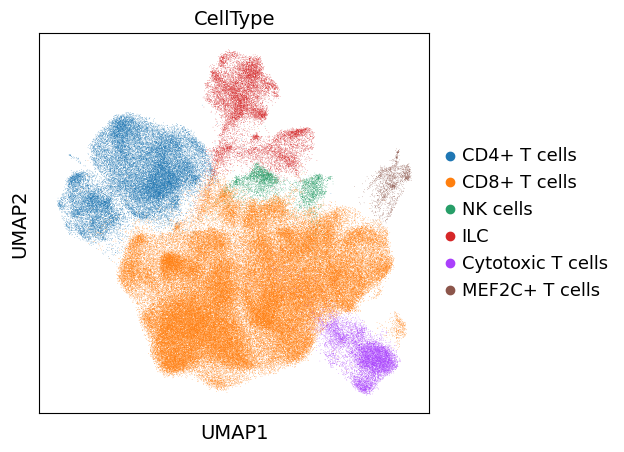

In [278]:
sc.pl.umap(T,color='CellType')

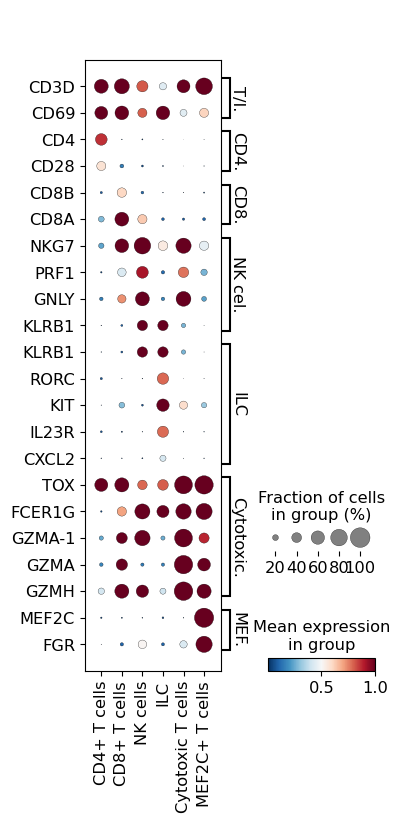

In [282]:
marker_genes_dict = {
'T/ILC':['CD3D','CD69'],
"CD4+ T cells":['CD4','CD28'],
"CD8+ T cells":['CD8B','CD8A'],
'NK cells':['NKG7','PRF1','GNLY','KLRB1'],
"ILC":['KLRB1','RORC','KIT','IL23R','CXCL2'],
"Cytotoxic T cells":['TOX','FCER1G','GZMA-1','GZMA','GZMH'],
'MEF2C+ T cells':['MEF2C','FGR'],
}
sc.pl.dotplot(T,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_T.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## Myeloid

In [283]:
mye=adata[adata.obs['Lineage']=='Myeloid lineage']

In [301]:
mye

AnnData object with n_obs × n_vars = 28956 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym', 'level3', 'Dataset', 'segment', 'stage', 'weaned', 'Disease', 'gender', 'region', 'breed', 'project'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'level3_colors', 'lym_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'tsne', 'umap', 'CellType_colors'
    obsm: 'X_scVI', 'X_tsne', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

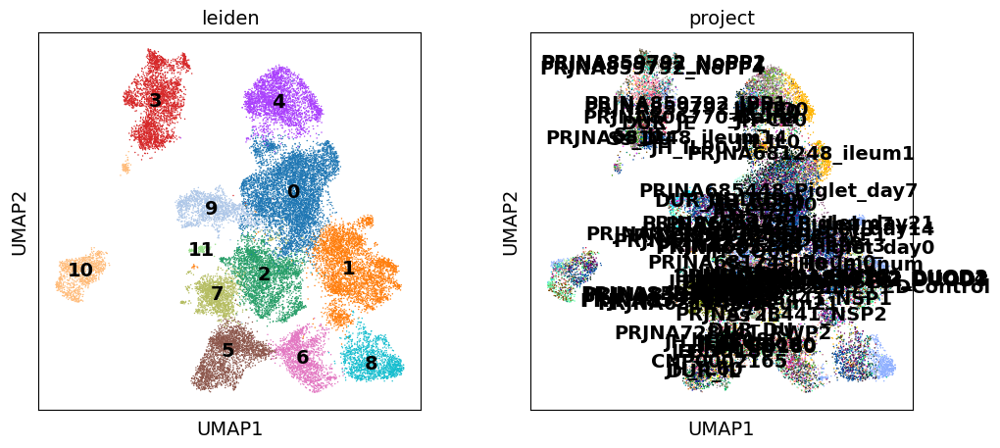

In [285]:
sc.pp.neighbors(mye, use_rep = 'X_scVI')
sc.tl.umap(mye)
sc.tl.leiden(mye, resolution = 0.4)
sc.pl.umap(mye, color=['leiden','project'],legend_loc='on data')

In [286]:
def function(a):
    if a in ['2','5','7','9']:
        return "Macrophage"
    elif a in ['0','4']:
        return "Monocyte"
    elif a in ['3']:
        return "Dendritic1"
    elif a in ['6','8']:
        return "Dendritic2"
    elif a in ['10']:
        return "Mast"
    elif a in ['11']:
        return "Plasmacytoid DCs"
    elif a in ['1']:
        return "mass"
df = mye.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mye.obs=df 
#跨列操作，与axis=0对应

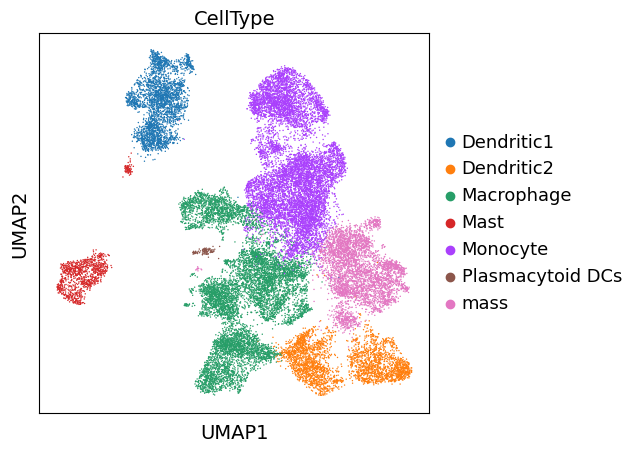

In [287]:
sc.pl.umap(mye, color=["CellType"])

In [288]:
mass=mye[mye.obs['CellType']=='mass']

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/scanpy/tools/_leiden.py:158: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[key_added] = pd.Categorical(


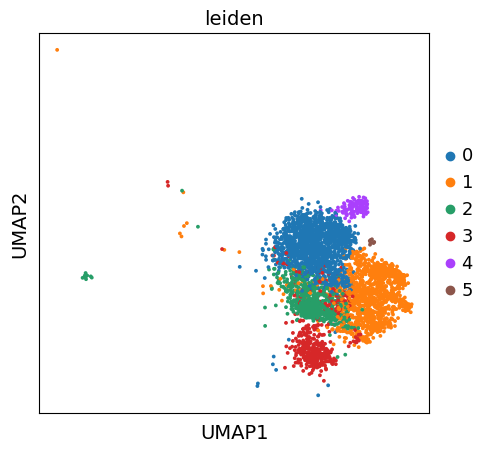

In [289]:
sc.tl.leiden(mass,resolution = 0.3)
sc.pl.umap(mass,color='leiden')

In [295]:
def function(a):
    if a in ['1','2','3','4']:
        return "Dendritic1"
    elif a in ['0','5']:
        return "Monocyte"
df = mass.obs
df["CellType"] = df.apply(lambda x: function(x['leiden']),axis=1)
mass.obs=df 
#跨列操作，与axis=0对应

In [296]:
mye.obs.loc[mass.obs_names,'CellType'] = mass.obs['CellType'].astype('object')
mye.obs['CellType'] = mye.obs['CellType'].cat.remove_unused_categories()

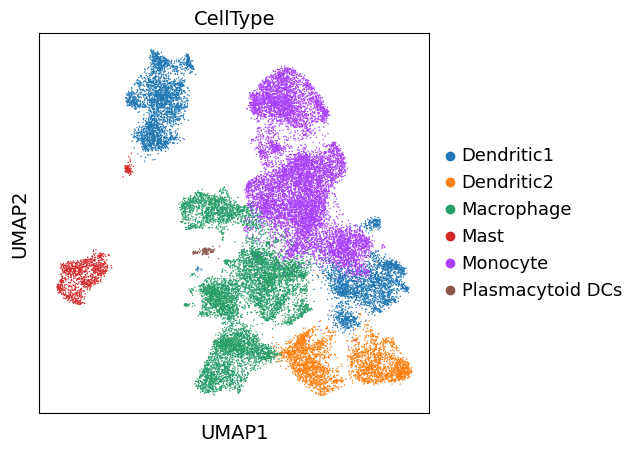

In [297]:
sc.pl.umap(mye, color=["CellType"])

In [298]:
df=adata.obs[['CellType']].astype(str)
df2=mye.obs[['CellType']].astype(str)
df=df.drop(df.index.intersection(df2.index))
df=pd.concat([df, df2])
# df=df.astype('category')
adata.obs['CellType']=df
adata.obs['CellType'].astype('category')

AAACCCAAGAGTTGAT-1_CNP0002165           Activated B cells
AAACCCAAGCAACTTC-1_CNP0002165           Activated B cells
AAACCCAAGCAGTCTT-1_CNP0002165                          TA
AAACCCAAGCGCATCC-1_CNP0002165           Activated B cells
AAACCCAAGGGTAGCT-1_CNP0002165           Activated B cells
                                              ...        
TTTGTTGCAATCGCCG-1_PRJNA859792_NoPP4         CD8+ T cells
TTTGTTGGTACCTAGT-1_PRJNA859792_NoPP4         CD8+ T cells
TTTGTTGGTACTAAGA-1_PRJNA859792_NoPP4    Cytotoxic T cells
TTTGTTGGTTTCGCTC-1_PRJNA859792_NoPP4                 EECs
TTTGTTGTCAGTGTCA-1_PRJNA859792_NoPP4         CD8+ T cells
Name: CellType, Length: 589101, dtype: category
Categories (40, object): ['Activated B cells', 'BEST4 enterocytes', 'CD4+ T cells', 'CD8+ T cells', ..., 'pericyte', 'smooth_muscle', 'stem', 'stromal??']

In [300]:
adata.obs['CellType'].value_counts()

CD8+ T cells             125732
Cycling B cells           59515
Activated B cells         57698
Enterocytes               45780
Resting B cells           39715
Coloncytes                33873
CD4+ T cells              31298
Immature Enterocytes      30447
Goblet                    20086
Plasma cells              19565
ILC                       12829
TA                        12680
BEST4 enterocytes         12179
Tuft                      10904
Monocyte                  10581
stem                       9017
Cytotoxic T cells          8984
Macrophage                 8623
Dendritic1                 5491
fibroblast                 5179
EECs                       4980
NK cells                   3915
Dendritic2                 3103
Lymphatic endothelium      2772
Venous                     2253
pericyte                   2162
neuron                     2020
MEF2C+ T cells             1591
arterial                   1459
Mast                       1071
Microfold                   803
smooth_m

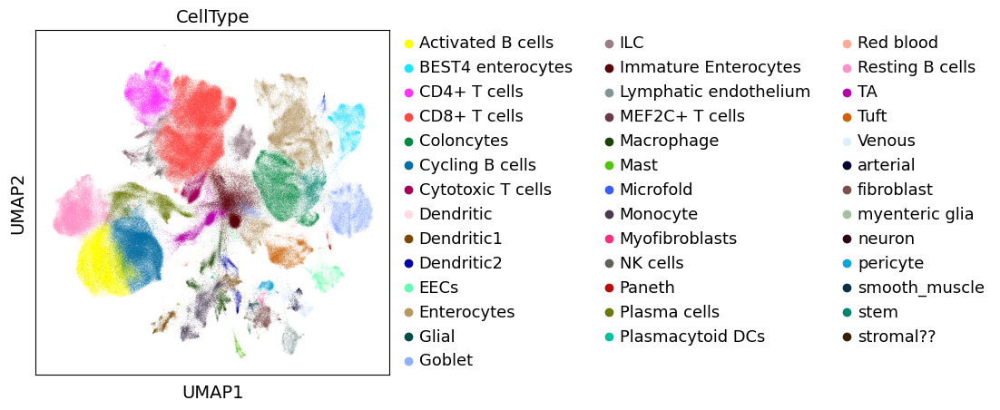

In [299]:
sc.pl.umap(adata,color='CellType')

In [ ]:
"Macrophage":['CD68','APOE','C1QA','C1QB','C1QC']
"monocyte":['CEBPB','S100A12','ENSSSCG00000029414']
"Dendritic1":['LTA4H','RETN','CEBPE','GSN']
"Dendritic2":['XCR1','SNX22']
"Mast":['MCT7','LTC4S','CCN3','LMNA','MS4A2']
"plasmacytoid DCs":['ENSSSCG00000010077','VPREB1', 'IRF7','MZB1']

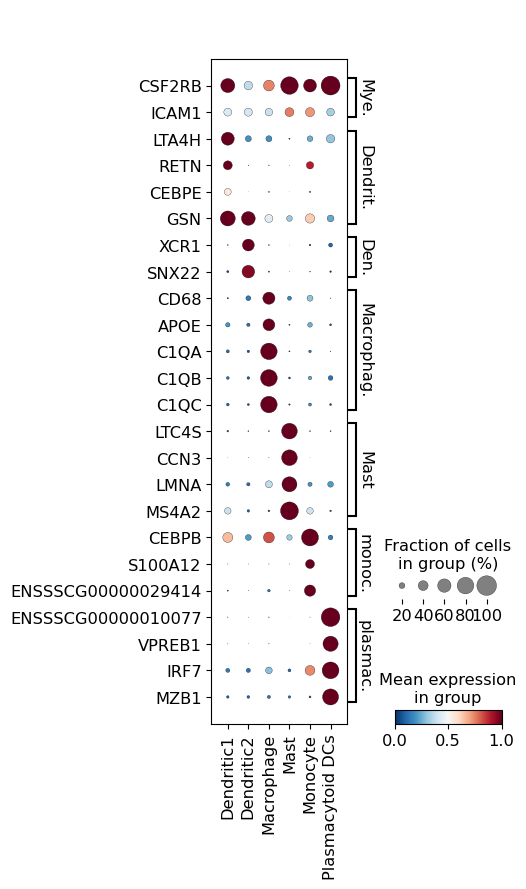

In [310]:
marker_genes_dict = {
'Myeloid':['CSF2RB', 'ICAM1'],
"Dendritic1":['LTA4H','RETN','CEBPE','GSN'],
"Dendritic2":['XCR1','SNX22'],
"Macrophage":['CD68','APOE','C1QA','C1QB','C1QC'],
"Mast":['LTC4S','CCN3','LMNA','MS4A2'],
"monocyte":['CEBPB','S100A12','ENSSSCG00000029414'],
"plasmacytoid DCs":['ENSSSCG00000010077','VPREB1', 'IRF7','MZB1']
}
sc.pl.dotplot(mye,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_myeloid.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## Endothelial lineage

In [308]:
endo=adata[adata.obs['Lineage']=='Endothelial lineage']

In [ ]:
"Venous":['ACKR1']
"Arterial":['GJA4', 'HEY1', 'HEY2', 'EFNB2']
"Lymphatic endothelium":['PROX1', 'LYVE1', 'CCL21']

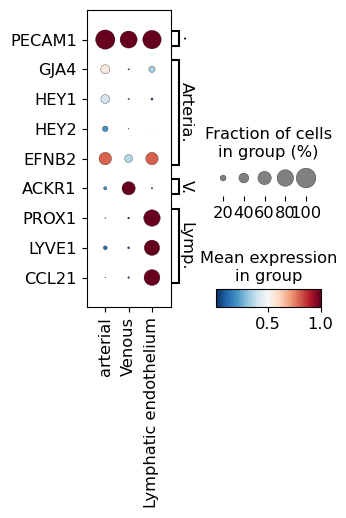

In [320]:
marker_genes_dict = {
"Endothelial lineage":['PECAM1'],
"Arterial":['GJA4', 'HEY1', 'HEY2', 'EFNB2'],
"Venous":['ACKR1'],
"Lymphatic endothelium":['PROX1', 'LYVE1', 'CCL21'],
}
sc.pl.dotplot(endo,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,figsize=(3,3.5),save='_marker_endo.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## Neural

In [327]:
neu=adata[adata.obs['CellType'].isin(['Glial','neuron'])]

In [ ]:
"Neural":['SOX10']
"Glial":['GFAP']
"Neuronal":['GAP43']

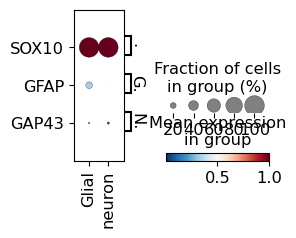

In [342]:
marker_genes_dict = {
"Neural":['SOX10'],
"Glial":['GFAP'],
"Neuronal":['GAP43'],
}
sc.pl.dotplot(neu,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,figsize=(2.5,1.5),save='_marker_neu.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## Mesenchymal

In [344]:
adata.obs['CellType'] = adata.obs['CellType'].replace('stromal??', 'C4A+ stromal')

In [346]:
mes=adata[adata.obs['Lineage']=='Mesenchymal lineage']

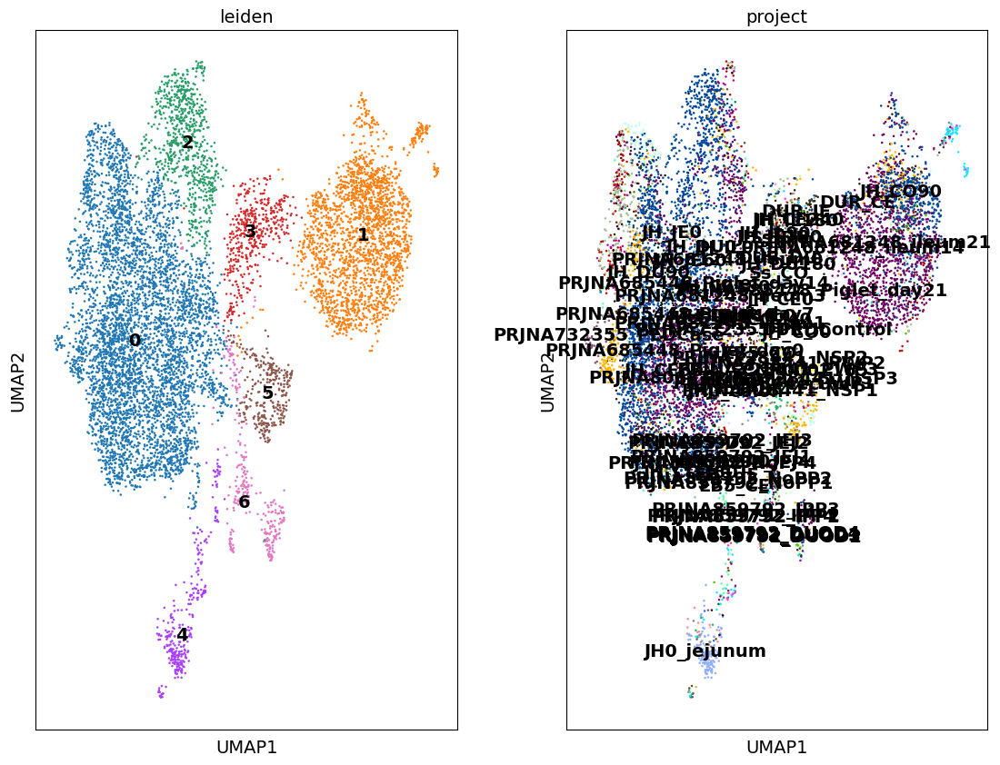

In [355]:
sc.pp.neighbors(mes, use_rep = 'X_scVI')
sc.tl.umap(mes)
sc.tl.leiden(mes, resolution = 0.2)
sc.pl.umap(mes, color=['leiden','project'],legend_loc='on data')

In [ ]:
"smooth_muscle":['MYOCD','DES','CNN1','ACTA2', 'MYH11']
"Myofibroblasts":['ACTA2','TAGLN','MYH11','TAGLN','ACTG2']
"fibroblast"
"pericyte":['NOTCH3', 'MCAM','RGS5','KCNJ8','ABCC9']
"myenteric glia":['GFAP','CD9']
"C4A+ stromal":['CLU','C3','C4A']

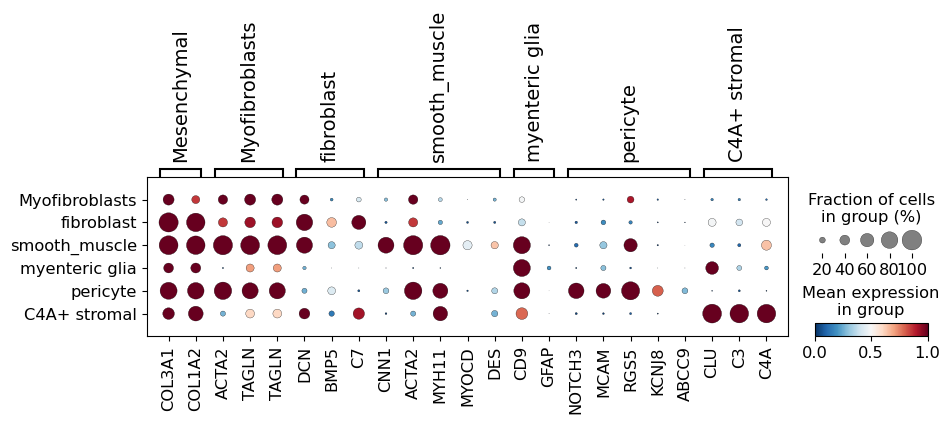

In [390]:
marker_genes_dict = {
"Mesenchymal":['COL3A1','COL1A2'],
"Myofibroblasts":['ACTA2','TAGLN','TAGLN'],
"fibroblast":['DCN','BMP5','C7'],
"smooth_muscle":['CNN1','ACTA2', 'MYH11','MYOCD','DES'],
"myenteric glia":['CD9','GFAP'],
"pericyte":['NOTCH3', 'MCAM','RGS5','KCNJ8','ABCC9'],
"C4A+ stromal":['CLU','C3','C4A']
}
sc.pl.dotplot(mes,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,save='_marker_mes.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

## Red blood

In [380]:
red=adata[adata.obs['Lineage']=='Red blood']

In [383]:
red.obs['CellType']

CGCCATTTCGTCAGAT-1_CNP0002165            Red blood
TTTGGTTTCATCGTAG-1_CNP0002165            Red blood
TGTGAGTAGATTGGGC-1_PRJNA681248_ileum0    Red blood
TTCCTTCTCGATACGT-1_PRJNA681248_ileum3    Red blood
ACCCTTGGTAAGATCA-1_PRJNA681248_ileum7    Red blood
                                           ...    
ATCCCTGCATACAGAA-1_PRJNA859792_IPP4      Red blood
TGTTCTACAGGTTCGC-1_PRJNA859792_IPP4      Red blood
ACTTATCCAGCCTATA-1_PRJNA859792_NoPP1     Red blood
ACTTATCCAGCCTATA-1_PRJNA859792_NoPP2     Red blood
CAGTTCCGTCGGTAAG-1_PRJNA859792_NoPP4     Red blood
Name: CellType, Length: 216, dtype: category
Categories (1, object): ['Red blood']

/disk211/public/anaconda3/envs/labBase/lib/python3.8/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


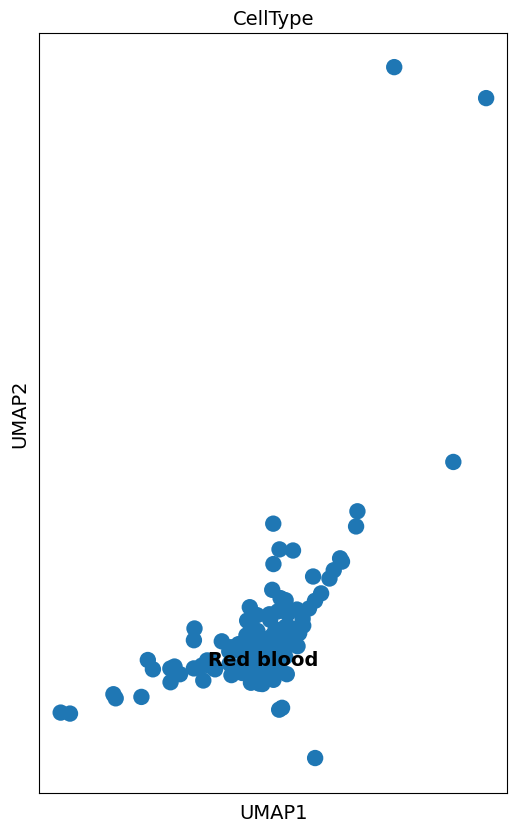

In [388]:
sc.pl.umap(red, color='CellType',legend_loc='on data')

In [ ]:
"RBC":['HBB','HBM']

## reorder

In [406]:
adata.obs["CellType"]

AAACCCAAGAGTTGAT-1_CNP0002165           Activated B cells
AAACCCAAGCAACTTC-1_CNP0002165           Activated B cells
AAACCCAAGCAGTCTT-1_CNP0002165                          TA
AAACCCAAGCGCATCC-1_CNP0002165           Activated B cells
AAACCCAAGGGTAGCT-1_CNP0002165           Activated B cells
                                              ...        
TTTGTTGCAATCGCCG-1_PRJNA859792_NoPP4         CD8+ T cells
TTTGTTGGTACCTAGT-1_PRJNA859792_NoPP4         CD8+ T cells
TTTGTTGGTACTAAGA-1_PRJNA859792_NoPP4    Cytotoxic T cells
TTTGTTGGTTTCGCTC-1_PRJNA859792_NoPP4                 EECs
TTTGTTGTCAGTGTCA-1_PRJNA859792_NoPP4         CD8+ T cells
Name: CellType, Length: 589101, dtype: category
Categories (38, object): ['Activated B cells', 'BEST4 enterocytes', 'C4A+ stromal', 'CD4+ T cells', ..., 'neuron', 'pericyte', 'smooth_muscle', 'stem']

In [405]:
adata.obs["CellType"].cat.categories.to_list()

['Activated B cells',
 'BEST4 enterocytes',
 'C4A+ stromal',
 'CD4+ T cells',
 'CD8+ T cells',
 'Coloncytes',
 'Cycling B cells',
 'Cytotoxic T cells',
 'Dendritic',
 'EECs',
 'Enterocytes',
 'Glial',
 'Goblet',
 'ILC',
 'Immature Enterocytes',
 'Lymphatic endothelium',
 'MEF2C+ T cells',
 'Macrophage',
 'Mast',
 'Microfold',
 'Monocyte',
 'Myofibroblasts',
 'NK cells',
 'Paneth',
 'Plasma cells',
 'Plasmacytoid DCs',
 'Red blood',
 'Resting B cells',
 'TA',
 'Tuft',
 'Venous',
 'arterial',
 'fibroblast',
 'myenteric glia',
 'neuron',
 'pericyte',
 'smooth_muscle',
 'stem']

In [407]:
cell=['stem',
'TA',
'Immature Enterocytes',
'Enterocytes',
'Coloncytes',
'BEST4 enterocytes',
'EECs',
'Goblet',
'Microfold',
'Paneth',
'Tuft',
'Activated B cells',
'Cycling B cells',
'Resting B cells',
'Plasma cells',
'CD4+ T cells',
'CD8+ T cells',
'MEF2C+ T cells',
'Cytotoxic T cells',
'ILC',
'NK cells',
'Macrophage',
'Mast',
'Monocyte',
'Dendritic',
'Plasmacytoid DCs',
'arterial',
'Venous',
'Lymphatic endothelium',
'Myofibroblasts',
'fibroblast',
'smooth_muscle',
'myenteric glia',
'pericyte',
'C4A+ stromal',
'Glial',
'neuron',
'Red blood']

In [409]:
adata.obs['CellType']=pd.Categorical(adata.obs['CellType'],categories=cell)

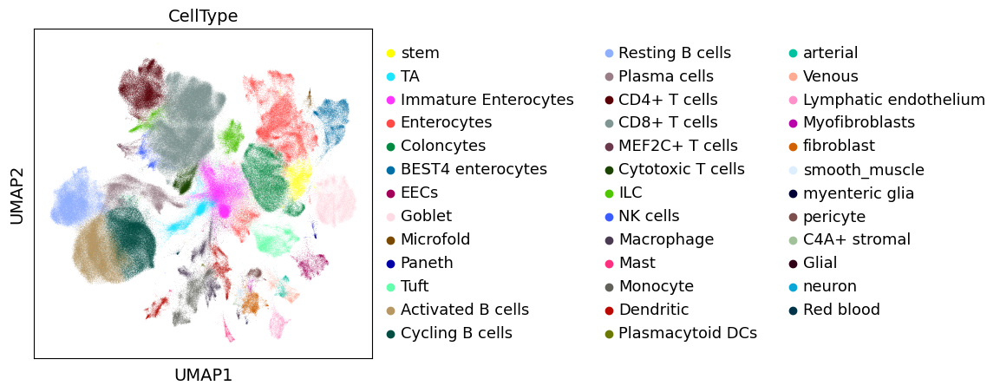

In [412]:
sc.pl.umap(adata,color='CellType')

In [413]:
colors=['#AE123AFF', '#D1283DFF', '#EA4C47FF', '#F67561FF', '#FB9B86FF', '#FFBEB2FF','#99D789FF','#B9C362FF','#CACACAFF','#09622AFF','#3B8C52FF',
 '#eedbbd','#e1a25f','#c26c43','#9f3632',
 '#b9ddf1','#94c1e0','#75a6cb','#5889b6','#42779e','#2a5783',
 '#d5d5d5','#a1a7a9','#707c83','#49525e', '#879195',
 '#FEFFD9FF', '#C4EAB1FF', '#41B7C4FF' ,
 '#eec9e5','#dbaccc','#c692b4','#af799f','#91648f','#7c4d79',
 '#aca4e2','#5cbd92',
 '#b9173a']

In [46]:
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(10, 10),color_map='Reds')

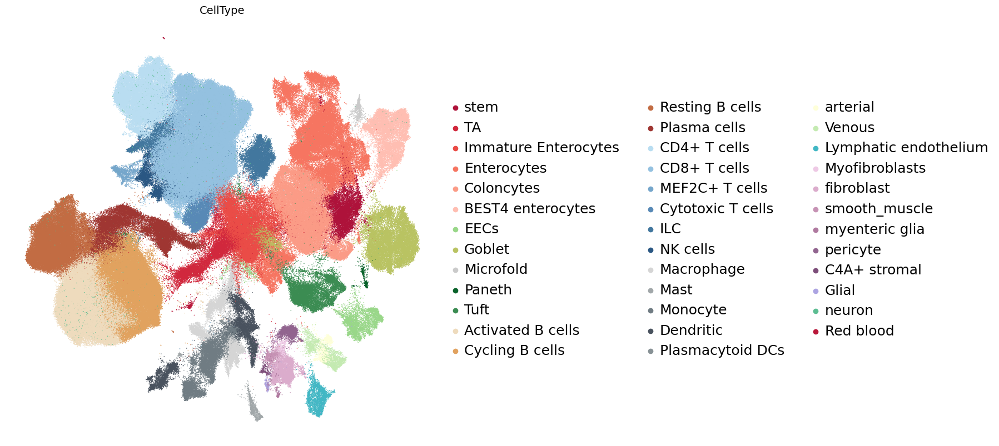

In [418]:
sc.pl.umap(adata,color='CellType',palette=colors,legend_fontsize=18, legend_fontweight='bold', title='CellType',size=5,frameon=False,save='_celltype_v2.pdf')

In [419]:
adata.write('/disk212/yupf/database/scRNA-seq/NewAtlas/atlas_level3_v2.h5ad')

: 

### new ajusted

In [2]:
adata=sc.read_h5ad('/disk212/yupf/database/scRNA-seq/NewAtlas/atlas_level3_v3.h5ad')

In [64]:
cell=['stem',
'TA',
'Immature Enterocytes',
'Enterocytes',
'Coloncytes',
'BEST4 enterocytes',
'EECs',
'Goblet',
'Microfold',
'Paneth',
'Tuft',
'Activated B cells',
'Cycling B cells',
'Resting B cells',
'Plasma cells',
'CD4+ T cells',
'CD8+ T cells',
'CD2+ gd T cells',
'CD2- gd T cells',
'NK cells',
'ILC1',
'ILC2',
'ILC3',
'Cytotoxic T cells',
'MEF2C+ T cells',
'Macrophage',
'Mast',
'Monocyte',
'Dendritic',
'Plasmacytoid DCs',
'arterial',
'Venous',
'Lymphatic endothelium',
'Myofibroblasts',
'fibroblast',
'smooth_muscle',
'myenteric glia',
'pericyte',
'C4A+ stromal',
'Glial',
'neuron',
'Red blood']

In [48]:
colors=['#AE123AFF', '#D1283DFF', '#EA4C47FF', '#F67561FF', '#FB9B86FF', '#FFBEB2FF','#99D789FF','#B9C362FF','#CACACAFF','#09622AFF','#3B8C52FF',
 '#eedbbd','#e1a25f','#c26c43','#9f3632',
 '#b9ddf1','#94c1e0','#75A3C2FF','#5E8DADFF','#75a6cb','#5889b6','#42779e','#4F82A6FF','#465F70FF','#2a5783',
 '#d5d5d5','#a1a7a9','#707c83','#49525e', '#879195',
 '#FEFFD9FF', '#C4EAB1FF', '#41B7C4FF' ,
 '#eec9e5','#dbaccc','#c692b4','#af799f','#91648f','#7c4d79',
 '#aca4e2','#5cbd92',
 '#b9173a']

In [65]:
adata.obs['CellType']=pd.Categorical(adata.obs['CellType'],categories=cell)

saving figure to file figures/umap_celltype_v3.pdf


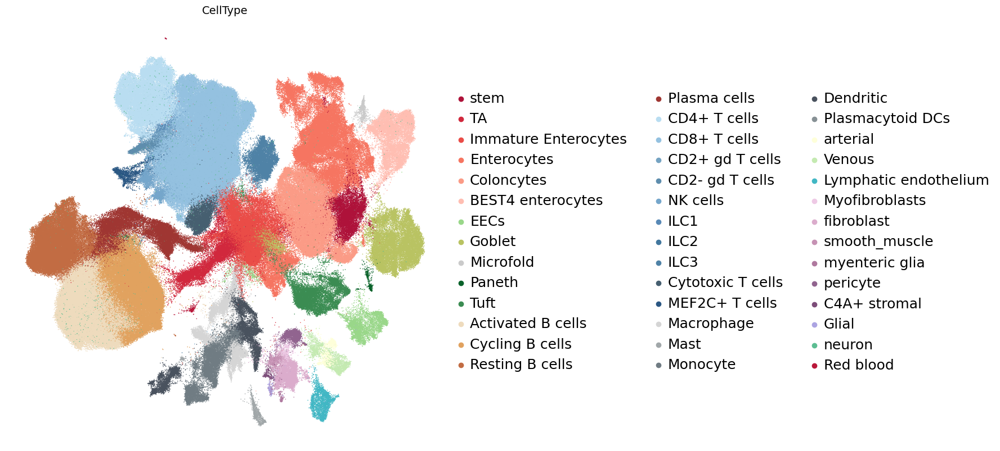

In [75]:
sc.pl.umap(adata,color='CellType',palette=colors,legend_fontsize=18, legend_fontweight='bold', title='CellType',size=5,frameon=False,save='_celltype_v3.pdf')

In [67]:
T_new=adata[adata.obs['Lineage']=='T/ILC lineage']

In [68]:
T_new

View of AnnData object with n_obs × n_vars = 184349 × 19346
    obs: 'doublet_score', 'predicted_doublet', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'phase', '_scvi_batch', '_scvi_labels', 'leiden', 'predicted_labels', 'over_clustering', 'majority_voting', 'conf_score', 'Lineage', 'CellType', 'lym', 'level3', 'Dataset', 'segment', 'stage', 'weaned', 'Disease', 'gender', 'region', 'breed', 'project', 'age'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'CellType_colors', 'Lineage_colors', '_scvi_manager_uuid', '_scvi_uuid', 'hvg', 'leiden', 'leiden_colors', 'level3_colors', 'lym_colors', 'majority_voting_colors', 'neighbors', 'project_colors', 'stage_colors', 'tsne', 'umap'
    obsm: 'X_scVI', 'X_tsne', 'X_umap', '_scvi_extra_categorical_covs'
    obsp: 'connectivities', 'distances'

saving figure to file figures/dotplot__marker_Tv2.pdf


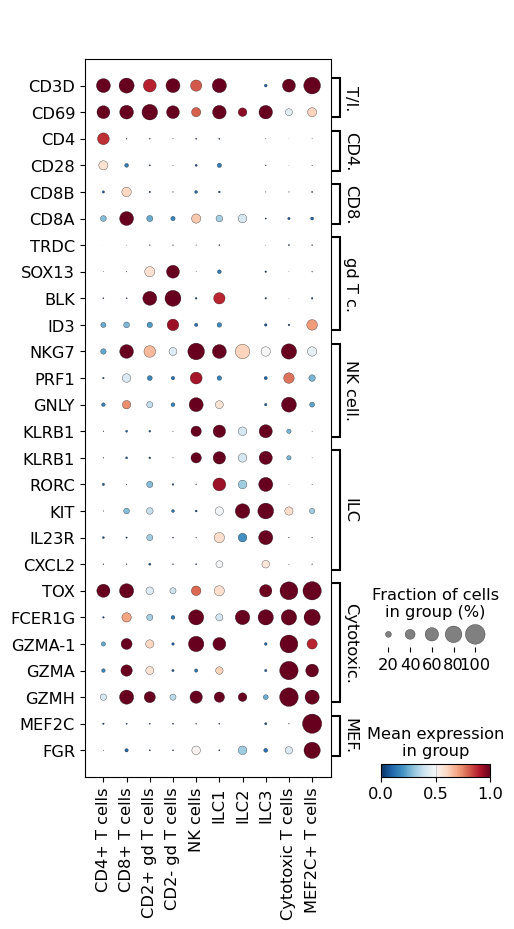

In [74]:
marker_genes_dict = {
'T/ILC':['CD3D','CD69'],
"CD4+ T cells":['CD4','CD28'],
"CD8+ T cells":['CD8B','CD8A'],
# "CD2+ gd T cells":['CD2','GATA3'],
"gd T cells":['TRDC','SOX13','BLK','ID3'],
'NK cells':['NKG7','PRF1','GNLY','KLRB1'],
# "ILC1":['CD247','CD96','ITGAE'],
# "ILC2":['PTGDR2','CD44','CD81'],
# "ILC3":['KIT','IL7R','IL23R'],
"ILC":['KLRB1','RORC','KIT','IL23R','CXCL2'],
"Cytotoxic T cells":['TOX','FCER1G','GZMA-1','GZMA','GZMH'],
'MEF2C+ T cells':['MEF2C','FGR'],
}
sc.pl.dotplot(T_new,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_Tv2.pdf')
# sc.pl.rank_genes_groups_dotplot(adata, var_names=marker_genes_dict, key='rank_genes_groups_Lineage', standard_scale='var')

In [6]:
ILC_order=['ILC1','ILC2','ILC3']

In [7]:
ILC=adata[adata.obs['CellType'].isin(ILC_order)]

In [61]:
ILC.obs['CellType']=pd.Categorical(ILC.obs['CellType'],categories=ILC_order)

saving figure to file figures/dotplot__marker_ILC_v2.pdf


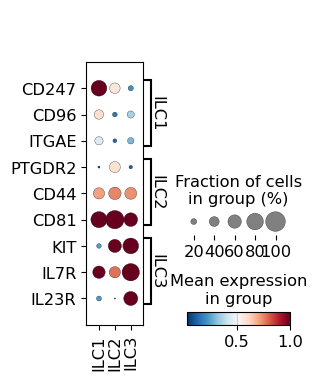

In [113]:
marker_genes_dict = {
"ILC1":['CD247','CD96','ITGAE'],
"ILC2":['PTGDR2','CD44','CD81'],
"ILC3":['KIT','IL7R','IL23R'],
}
sc.pl.dotplot(ILC,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_ILC_v2.pdf')

In [ ]:
marker_genes_dict = {
"CD2+ gd T cells":['CD2','GATA3'],
"CD2- gd T cells":['TRDC','SOX13','BLK','ID3'],
# 'NK cells':['NKG7','PRF1','GNLY','KLRB1'],
}
sc.pl.dotplot(gdt,marker_genes_dict , groupby='CellType',cmap='RdBu_r',vmax=1,swap_axes=True,save='_marker_gdT_v2.pdf')

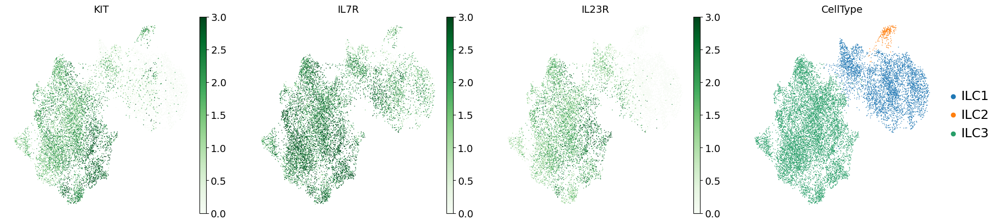

In [ ]:
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Greens')
sc.pl.umap(ILC,color=['KIT','CellType'],legend_fontsize=18, legend_fontweight='bold',vmax=3,size=5,frameon=False)

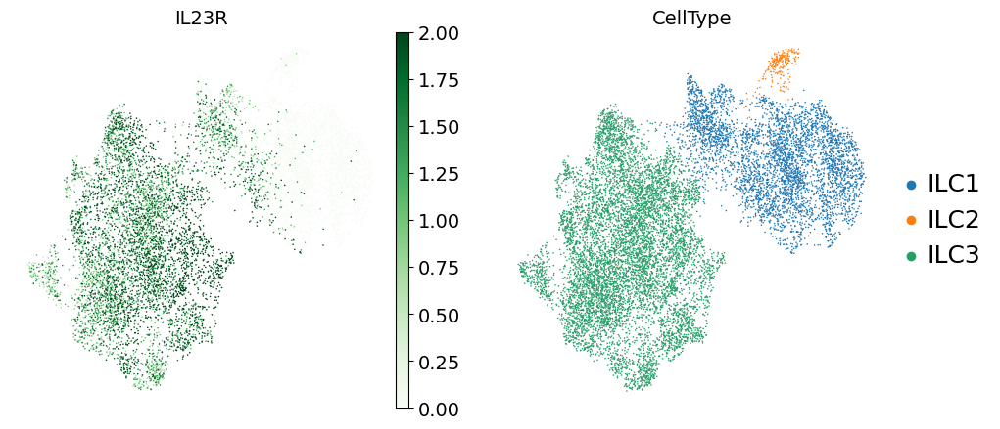

In [20]:
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Greens')
umap=sc.pl.umap(ILC,color=['IL23R','CellType'],legend_fontsize=18, legend_fontweight='bold',vmax=2,size=5,frameon=False,return_fig=True)
umap.savefig("/disk212/yupf/database/scRNA-seq/NewAtlas/figures/IL23R.pdf", dpi=300, bbox_inches="tight")

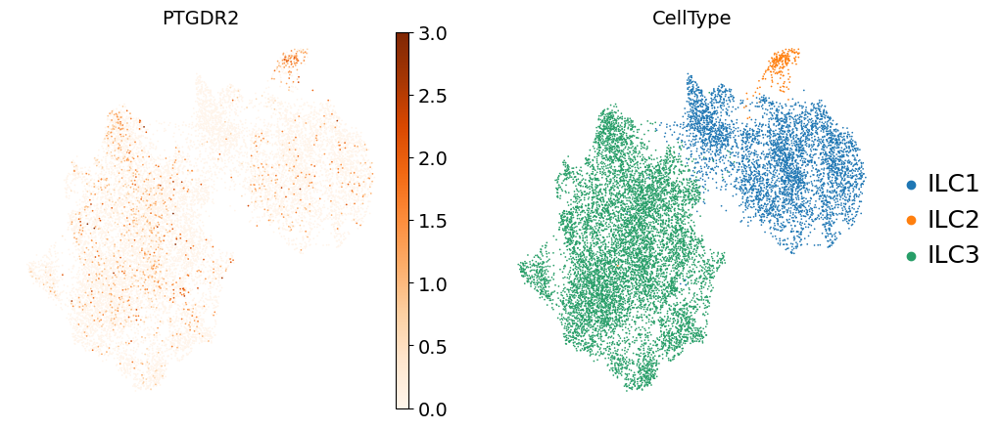

In [21]:
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Oranges')
umap=sc.pl.umap(ILC,color=['PTGDR2','CellType'],legend_fontsize=18, legend_fontweight='bold',vmax=3,size=6,frameon=False,return_fig=True)
umap.savefig("/disk212/yupf/database/scRNA-seq/NewAtlas/figures/PTGDR2.pdf", dpi=300, bbox_inches="tight")

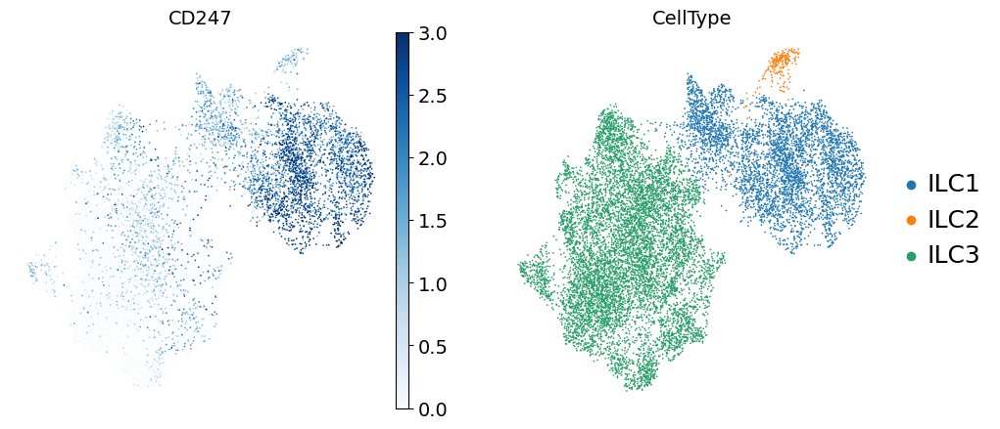

In [22]:
sc.set_figure_params(dpi=50, dpi_save=300, figsize=(5, 5),color_map='Blues')
umap=sc.pl.umap(ILC,color=['CD247','CellType'],legend_fontsize=18, legend_fontweight='bold',vmax=3,size=6,frameon=False,return_fig=True)
umap.savefig("/disk212/yupf/database/scRNA-seq/NewAtlas/figures/CD247.pdf", dpi=300, bbox_inches="tight")

In [114]:
adata.write('/disk212/yupf/database/scRNA-seq/NewAtlas/atlas_level3_v3.h5ad')